In [23]:
import librosa
import librosa.display

import cv2
import os

import numpy as np
import matplotlib.pyplot as plt

from IPython.display import Audio
import soundfile as sf
cv2.__version__

'4.5.5'

In [24]:
filename = 'Tears_of_a_witch_SFA_44100.npz'
y = np.load(filename)['sig']
sr = 44100
print(y.shape, sr)

(6849536,) 44100


In [25]:
onset_env = librosa.onset.onset_strength(y=y, sr=sr)

# Run the default beat tracker
tempo, beat_frames = librosa.beat.beat_track(y=y, sr=sr)
print('Estimated tempo: {:.2f} beats per minute'.format(tempo))

# dynamic tempo
dtempo = librosa.beat.tempo(onset_envelope=onset_env, sr=sr,
                            aggregate=None)

Estimated tempo: 120.19 beats per minute


In [26]:
stft = librosa.stft(y)
harmonic, percussive = librosa.decompose.hpss(stft, margin=(1,15))

In [27]:
y_harmonic = librosa.istft(harmonic)
sf.write('output/harmonic.wav', y_harmonic,sr,"PCM_24")
Audio(y_harmonic,rate=sr)

In [28]:
y_percussive = librosa.istft(percussive)
sf.write('output/percussive.wav', y_percussive,sr,"PCM_24")
Audio(y_percussive,rate=sr)

In [29]:
def cut_load(src,idx):
    div2_l = 250
    _, length = src.shape
    print(length)
    print(div2_l*(idx-1),div2_l*(idx+1))
    if length < div2_l*2:
        result = src.copy()
    elif div2_l*(idx-1) > length:
        result = src[:,length-(div2_l*2):length].copy()
    elif div2_l*(idx+1) > length:
        result = src[:,div2_l*(idx-1):length].copy()        
    else:
        result = src[:,div2_l*(idx-1):div2_l*(idx+1)].copy()        
    return result



13379
0 500


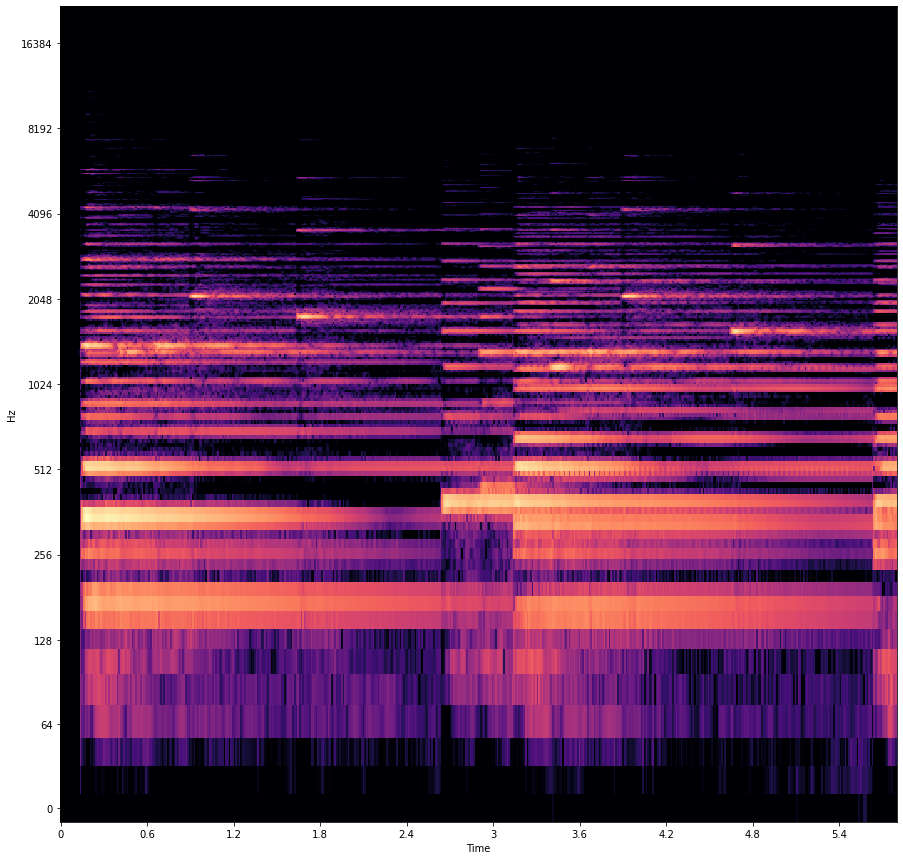

In [30]:
idx = 1
crop = cut_load(harmonic,idx)
rp = np.max(np.abs(stft))
db = librosa.amplitude_to_db(np.abs(crop),ref=rp)

fig, ax = plt.subplots(1,1,figsize=(15,15))
img = librosa.display.specshow(db,sr=sr,x_axis='time',y_axis='log',ax=ax,fmax=20000)
plt.show()

In [31]:


frames = beat_frames[(250*(idx-1)<beat_frames)&(beat_frames<250*(idx+1))]-(250*(idx-1))
        beat_times = librosa.frames_to_time(frames, sr=sr)
        notes = ['C','','D','','E','','F#','','G#','','A#','']
        y_ticks = np.arange(0,12*freq_w*octave,freq_w)
        y_list=[]

        for o in range(octave):
            for i in range(12):
                y_list.append(notes[i]+'%d'%(o+1))

        plt.style.use('default')
        fig, ax = plt.subplots(1,1,figsize=(15,10))
        img = librosa.display.specshow(crop, sr=sr, x_axis='time', ax=ax, hop_length= hop_len, bins_per_octave= 12*freq_w,
                                    cmap='jet'
                                    )
        ax.set(title=filename+str(idx))
        ax.set_yticks(y_ticks)
        ax.set_yticklabels(y_list)
        
        for i,v in zip(range(len(beat_times)),beat_times):
            if i % 4==0:
                ax.axvline(v,c='white')
            else:
                ax.axvline(v,c='k')
                
        for i in np.arange(0,12*freq_w*octave,freq_w):
            if i % (freq_w*12) ==0:
                ax.axhline(i,c='g')
            elif i % (freq_w*2) ==0:
                ax.axhline(i,c='k')
            else:
                ax.axhline(i,c='white')
            
        plt.savefig('./output/'+filename.split('.')[0]+str(idx))
        print(filename.split('.')[0]+str(idx),'save complete')
        plt.show()

IndentationError: unexpected indent (2595728097.py, line 2)